In [2]:
from __future__ import print_function
import numpy as np
import matplotlib.pyplot as plt
import librosa
import IPython.display as ipd
import librosa.display

In [4]:
file_name = 'just_a_dream.wav'
y, sr = librosa.load(file_name)
y_D = librosa.stft(y)
y_harmonic_component, y_percussive_component = librosa.decompose.hpss(y_D)
y_harmonic = librosa.istft(y_harmonic_component)

file_name2 = 'just_a_dream_vocal_mono.wav'
y_2, sr = librosa.load(file_name2)

# chroma_1 = librosa.feature.chroma_stft(y=y, sr=sr)
chroma_1_harmonic = librosa.feature.chroma_stft(y=y_harmonic, sr=sr) 
chroma_2 = librosa.feature.chroma_stft(y=y_2, sr=sr)

In [4]:
ipd.Audio(y_2, rate=sr)

In [5]:
def librosa_dtw(X,Y, title='Database excerpt', color='y'):
    D, wp = librosa.dtw(X, Y, subseq=True)
#     librosa.display.specshow(D, x_axis='frames', y_axis='frames')
#     plt.plot(wp[:, 1], wp[:, 0], label='Optimal path', color=color) #this will plot the Y as horizontal and X as vertical
    return D,wp




In [6]:
d, wp = librosa_dtw(chroma_2,chroma_1_harmonic)

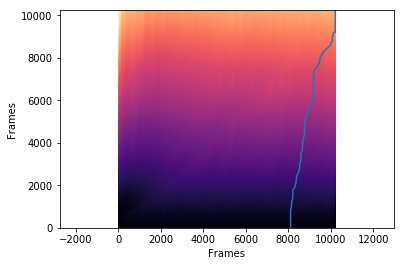

In [14]:
def graph(d, wp):
    librosa.display.specshow(d, x_axis='frames', y_axis='frames')
    plt.axis('equal')
    plt.plot(wp[:, 1], wp[:, 0], label='Optimal path') #this will plot the Y as horizontal and X as vertical

graph(d,wp)

In [8]:
                                                                                                                                                                                                                                                                                                                                                                                                                test = wp[::-1]
import math

def take_mean(array):
    if len(array) == 0:
        return 0
    return sum([element[0] / element[1] for element in array]) / len(array)

def filter_similar_slope(num_per_batch, factor, array, start, end):
    test_array = array[start:end]
    batch_num = math.ceil(len(test_array) / num_per_batch)
    mean_array = []
    print("number of bathes", batch_num, "number per batch", num_per_batch)
    for i in range(batch_num):
        mean_array.append(take_mean(test_array[i*num_per_batch :(i+1) *num_per_batch ]))
#     print(mean_array)
    groups = []
    new_group = []
    for i in range(1,len(mean_array)):
        if mean_array[i - 1] * factor < mean_array[i] < mean_array[i - 1] * (1 - factor + 1) :
            new_group.append(i)
        else:
            if len(new_group) != 0:
                groups.append(new_group)
                new_group = []
    if len(new_group) != 0:
        groups.append(new_group)
#     print("length of group", len(groups), groups)
    return_group = max(groups, key=lambda x: len(x))
    return  start + return_group[0] * num_per_batch, start + return_group[-1] * num_per_batch

batch1_start, batch1_end = filter_similar_slope(100, 0.99, test, 0, len(test))
print(batch1_start, batch1_end)
batch2_start, batch2_end = filter_similar_slope(50, 0.99, test, batch1_start, batch1_end)
print(batch2_start,batch2_end)
batch3_start, batch3_end = filter_similar_slope(20, 0.99, test, batch2_start, batch2_end)
print(batch3_start, batch3_end)
print(take_mean(test[batch3_start: batch3_end]))
final_offset = sum(i[1] - i[0] for i in test[batch3_start: batch3_end]) // len(test[batch3_start: batch3_end])
print(final_offset)

number of bathes 104 number per batch 100
8000 8800
number of bathes 16 number per batch 50
8050 8750
number of bathes 35 number per batch 20
8070 8730
0.8573487222593211
1392


In [9]:
def restretch(audio_to_use, offset):
    offset_frame = librosa.frames_to_samples(offset)
    noise = np.zeros(offset_frame)
    restretch_data = np.concatenate((noise, audio_to_use), axis=0)
    return restretch_data
restretch_song = restretch(y_2, final_offset)

In [12]:
print(len(restretch_song), len(y_2), len(y))

5953728 5241024 5241024


In [13]:
padding = np.zeros(len(y) - len(restretch_song))
final_vocal_audio = np.concatenate((restretch_song,padding), axis=0)
print(len(final_vocal_audio))

ValueError: negative dimensions are not allowed

In [15]:
final_mix = y + y_2
print(len(final_mix))

5241024


In [103]:
librosa.output.write_wav("just_a_dream_vocal_mono.wav", final_vocal_audio, sr)

In [16]:
ipd.Audio(final_mix, rate=sr)

In [18]:
ipd.Audio(y, rate=sr)